In [1]:
# Required libraries:
# pip install pytesseract pdf2image pillow
# Also install Tesseract OCR on your system:
#   Windows: https://github.com/UB-Mannheim/tesseract/wiki
#   Ubuntu:  sudo apt install tesseract-ocr
#   Mac:     brew install tesseract

import pytesseract
from pdf2image import convert_from_path
from PIL import Image
import os

# ───────────────────────────────────────────────
#  Option 1: Most common simple version (one page)
# ───────────────────────────────────────────────

def extract_text_from_scanned_pdf(pdf_path, page_number=1):
    # Convert PDF page → image
    images = convert_from_path(pdf_path, first_page=page_number, last_page=page_number)
    
    if not images:
        return "Could not read PDF"
    
    # Usually we take the first (and only) page image
    page_image = images[0]
    
    # Optional: increase accuracy for low-quality scans
    # page_image = page_image.resize((page_image.width*2, page_image.height*2), Image.Resampling.LANCZOS)
    
    # Important: tell pytesseract the language(s)
    # You can use multiple: "eng+urd+ara"
    text = pytesseract.image_to_string(page_image, lang='eng')

    return text.strip()


# ───────────────────────────────────────────────
#  Option 2: Extract text from ALL pages
# ───────────────────────────────────────────────

def extract_text_from_all_pages(pdf_path, lang='eng'):
    print(f"Converting PDF to images... ({pdf_path})")
    
    # dpi=300 is good balance between quality & speed
    images = convert_from_path(pdf_path, dpi=300, poppler_path="C:\\Users\\LENOVO\\poppler-25.12.0\\Library\\bin")
    
    full_text = []
    
    for i, image in enumerate(images, 1):
        print(f"  OCR page {i}/{len(images)}...", end="", flush=True)
        text = pytesseract.image_to_string(image, lang=lang)
        full_text.append(f"───── Page {i} ─────\n{text.strip()}\n")
        print(" done")
    
    return "\n\n".join(full_text)


# ───────────────────────────────────────────────
#               How to use it
# ───────────────────────────────────────────────

if __name__ == "__main__":
    # Change this to your file
    pdf_file = "PIXIS.pdf"
    # pdf_file = "result_2025-08_scan.pdf"

    if not os.path.exists(pdf_file):
        print("File not found:", pdf_file)
    else:
        # Single page version
        # result = extract_text_from_scanned_pdf(pdf_file, page_number=1)
        # print(result)

        # All pages version (most common choice)
        result = extract_text_from_all_pages(pdf_file, lang='eng')
        print(result)

        # Optional: save to file
        with open("extracted_text.txt", "w", encoding="utf-8") as f:
            f.write(result)
        print("\nSaved to extracted_text.txt")

Converting PDF to images... (PIXIS.pdf)
  OCR page 1/12... done
  OCR page 2/12... done
  OCR page 3/12... done
  OCR page 4/12... done
  OCR page 5/12... done
  OCR page 6/12... done
  OCR page 7/12... done
  OCR page 8/12... done
  OCR page 9/12... done
  OCR page 10/12... done
  OCR page 11/12... done
  OCR page 12/12... done
───── Page 1 ─────
Aiquire Inc. (“Pixis”)

+
21 W 46TH ST STE 0801, PIRIS
NEW YORK, NY 10036, USA www pixis.ai

Email ID: accounts@aiquire.com /legal@pixis.ai

ORDER FORM

CONTRACT INFORMATION
Customer Name

TRES PUNTO CERO DIGITAL, S.A. DE
GY:

Contact Name

Ricardo Rodriguez Landeros

Effective Date
The date on which this Order Form is
executed by the Customer

Offer Expiration Date
This offer is valid until the date specified
on the Order Form.

Phone

+525536667581 Onboarding Start Date
The Onboarding shall commence on the
Email Effective Date.

ricardo@3zero.mx

Service Start Date
The date of commencement of the Service
Term shall be the same as the Onboar

# Test API with PDF Upload

This notebook tests the FastAPI PDF OCR endpoint by uploading a PDF and displaying the results.

In [3]:
import requests
import base64
from PIL import Image
import io
from IPython.display import display, HTML
import os

# Configuration
API_URL = "http://localhost:8000/extract-pdf"
PDF_FILE = "PIXIS.pdf"  # Change this to your PDF file
OUTPUT_DIR = "output"

# Create output directory
os.makedirs(OUTPUT_DIR, exist_ok=True)

In [5]:
# Upload PDF to API
print(f"📄 Uploading: {PDF_FILE}")

with open(PDF_FILE, 'rb') as f:
    files = {'file': (PDF_FILE, f, 'application/pdf')}
    params = {'lang': 'eng'}
    
    response = requests.post(API_URL, files=files, params=params)

if response.status_code == 200:
    result = response.json()
    print(f"✅ Success! Processed {result['total_pages']} pages")
else:
    print(f"❌ Error: {response.status_code}")
    print(response.text)

📄 Uploading: PIXIS.pdf
✅ Success! Processed 12 pages



PAGE 1
💾 Image saved: output\page_001.png


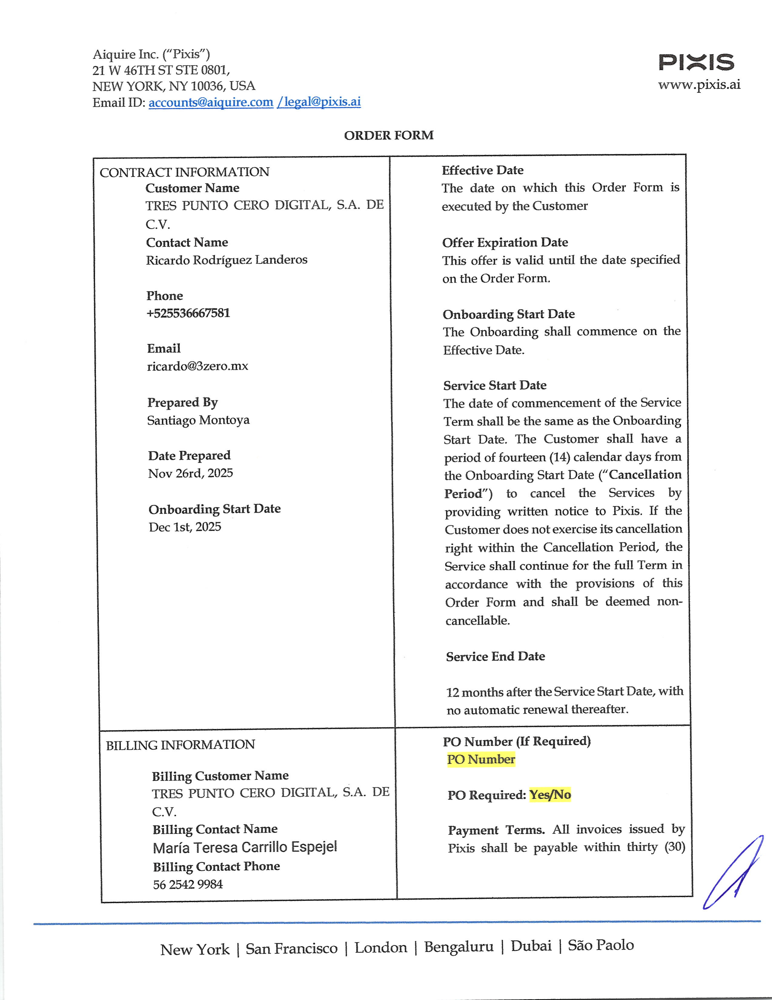


📝 Extracted Text:
------------------------------------------------------------
Aiquire Inc. (“Pixis”)

Se
21 W 46TH ST STE 0801, PIRIS
NEW YORK, NY 10036, USA www. pixis.ai

Email ID: accounts@aiquire.com /legal@pixis.ai

ORDER FORM

CONTRACT INFORMATION
Customer Name

TRES PUNTO CERO DIGITAL, S.A. DE
GY:

Contact Name

Ricardo Rodriguez Landeros

Effective Date
The date on which this Order Form is
executed by the Customer

Offer Expiration Date
This offer is valid until the date specified
on the Order Form.

Phone

+525536667581 Onboarding Start Date
The Onboarding shall commence on the
Email Effective Date.

ricardo@3zero.mx

Service Start Date
The date of commencement of the Service
Term shall be the same as the Onboarding
Start Date. The Customer shall have a
period of fourteen (14) calendar days from
the Onboarding Start Date (“Cancellation
Period”) to cancel the Services by
providing written notice to Pixis. If the
Customer does not exercise its cancellation
right within the Can

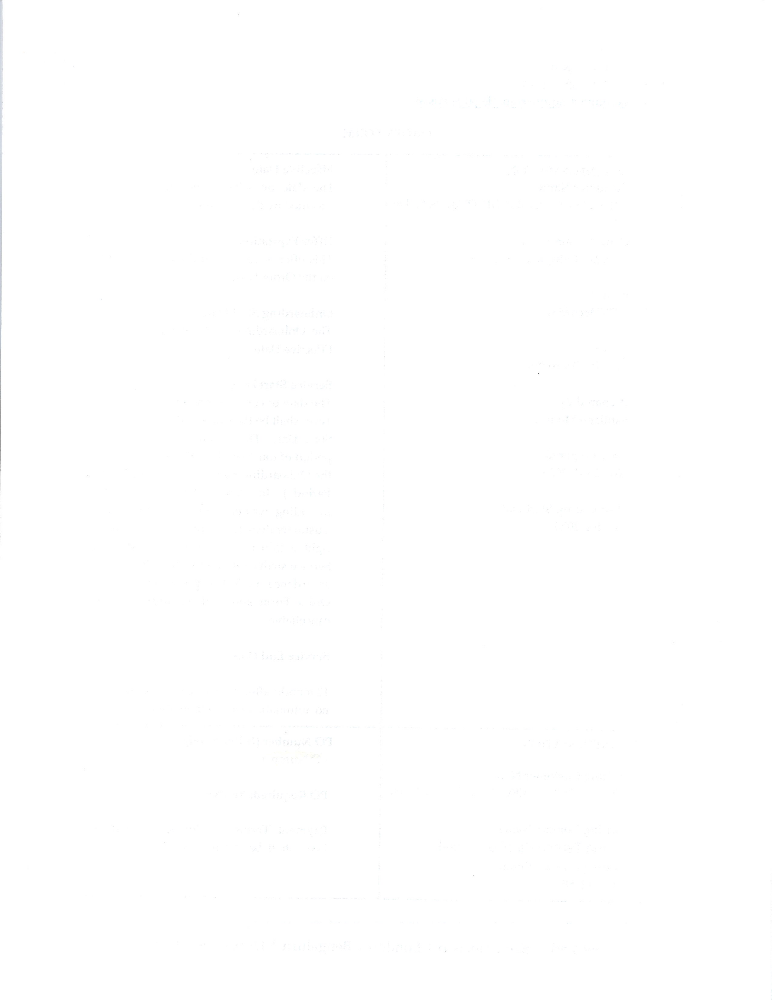


📝 Extracted Text:
------------------------------------------------------------
(No text found)
------------------------------------------------------------
💾 Text saved: output\page_002.txt

PAGE 3
💾 Image saved: output\page_003.png


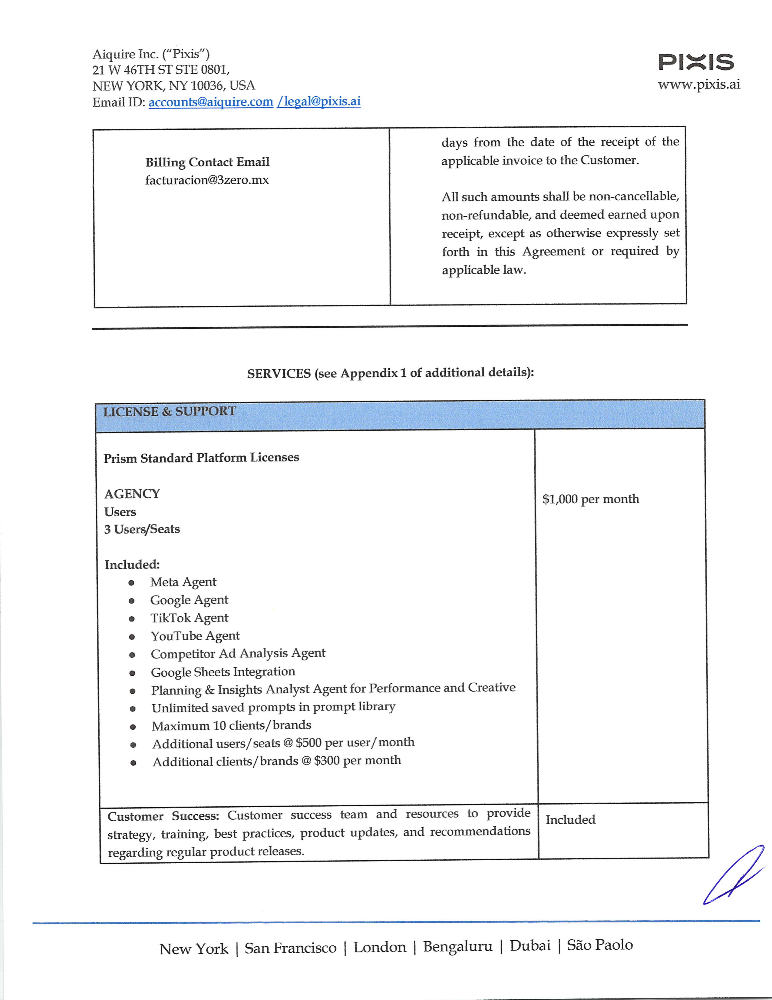


📝 Extracted Text:
------------------------------------------------------------
Aiquire Inc. (“Pixis”) w
21 W 46TH ST STE 0801, PIRIS
NEW YORK, NY 10036, USA www.pixis.ai

Email ID: accounts@aiquire.com /legal@pixis.ai

days from the date of the receipt of the
Billing Contact Email applicable invoice to the Customer.
facturacion@3zero.mx

All such amounts shall be non-cancellable,

non-refundable, and deemed earned upon

receipt, except as otherwise expressly set
forth in this Agreement or required by
applicable law.

SERVICES (see Appendix 1 of additional details):

Prism Standard Platform Licenses

AGENCY
Users
3 Users/Seats

$1,000 per month

Included:
e Meta Agent
Google Agent
TikTok Agent
YouTube Agent
Competitor Ad Analysis Agent
Google Sheets Integration
Planning & Insights Analyst Agent for Performance and Creative
Unlimited saved prompts in prompt library
Maximum 10 clients/ brands
Additional users/seats @ $500 per user/month
Additional clients/ brands @ $300 per month

Custom

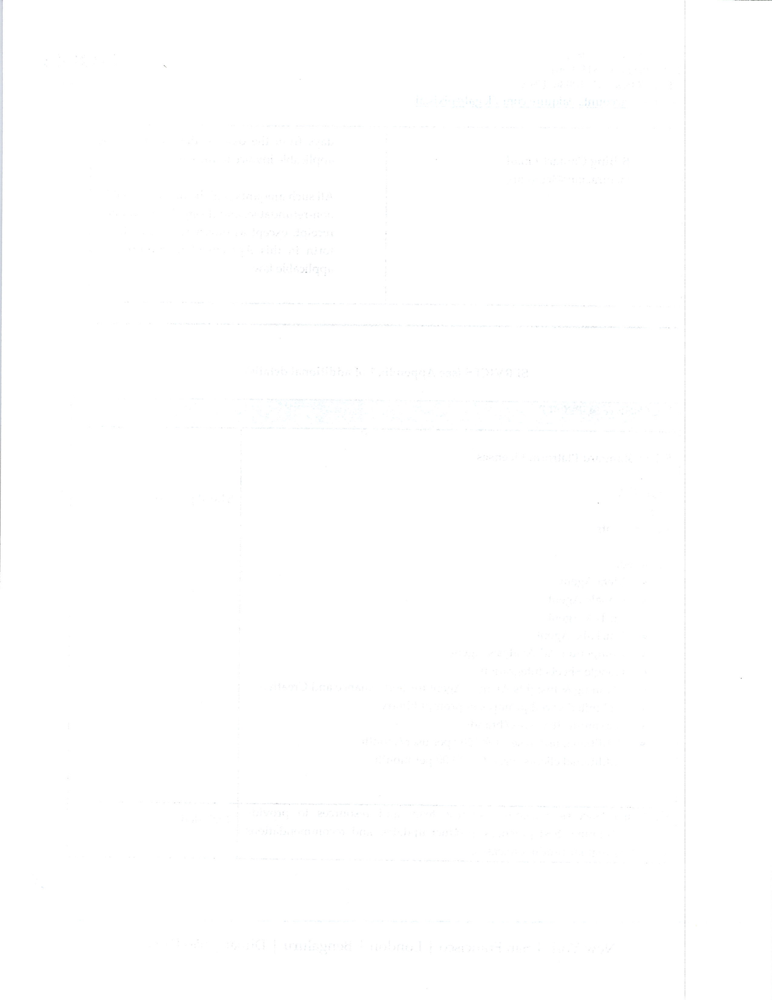


📝 Extracted Text:
------------------------------------------------------------
(No text found)
------------------------------------------------------------
💾 Text saved: output\page_004.txt

PAGE 5
💾 Image saved: output\page_005.png


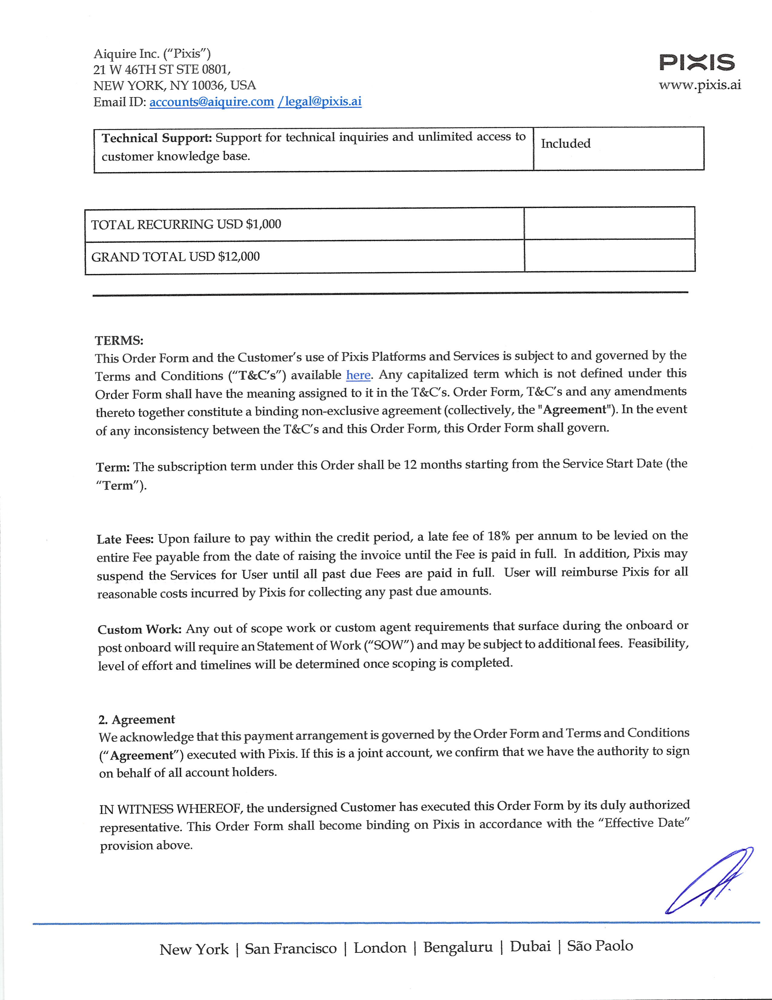


📝 Extracted Text:
------------------------------------------------------------
Aiquire Inc. (“Pixis”) alt
21 W 46TH ST STE 0801, PIFIS
NEW YORK, NY 10036, USA www.-pixis.ai

Email ID: accounts@aiquire.com /legal@pixis.ai
Technical Support: Support for technical inquiries and unlimited access to Included
customer knowledge base.

TOTAL RECURRING USD $1,000 re

TERMS:

This Order Form and the Customer’s use of Pixis Platforms and Services is subject to and governed by the
Terms and Conditions (“T&C's”) available here. Any capitalized term which is not defined under this
Order Form shall have the meaning assigned to it in the T&C’s. Order Form, T&C’s and any amendments
thereto together constitute a binding non-exclusive agreement (collectively, the "Agreement"). In the event
of any inconsistency between the T&C’s and this Order Form, this Order Form shall govern.

Term: The subscription term under this Order shall be 12 months starting from the Service Start Date (the
“Term’).

Late Fees

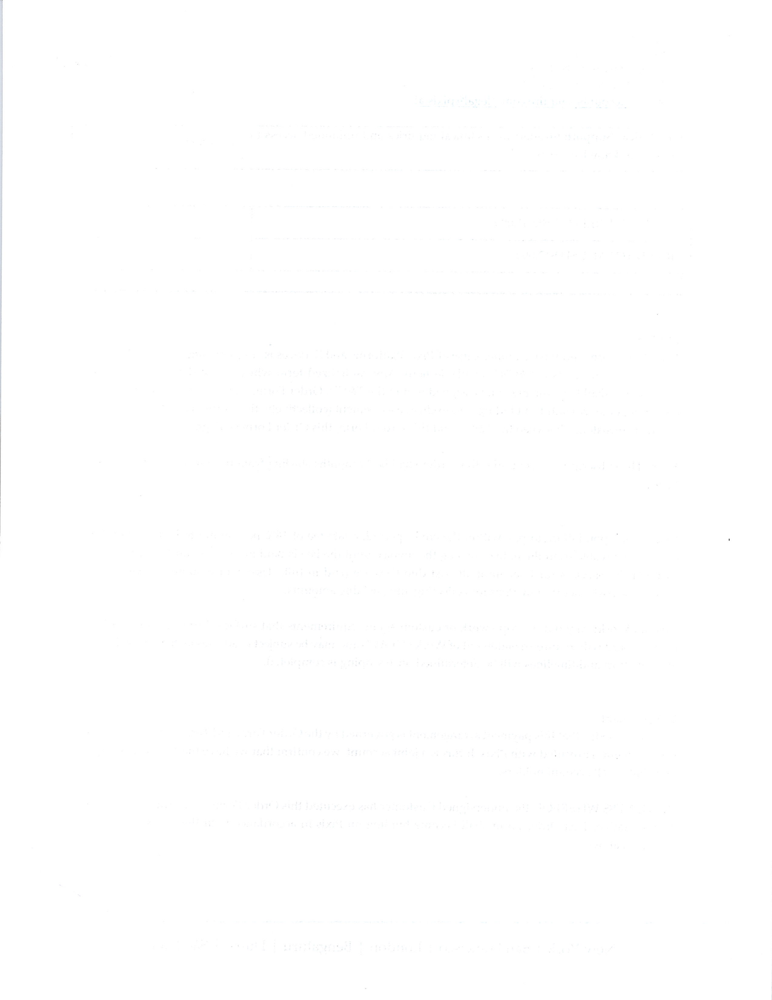


📝 Extracted Text:
------------------------------------------------------------
(No text found)
------------------------------------------------------------
💾 Text saved: output\page_006.txt

PAGE 7
💾 Image saved: output\page_007.png


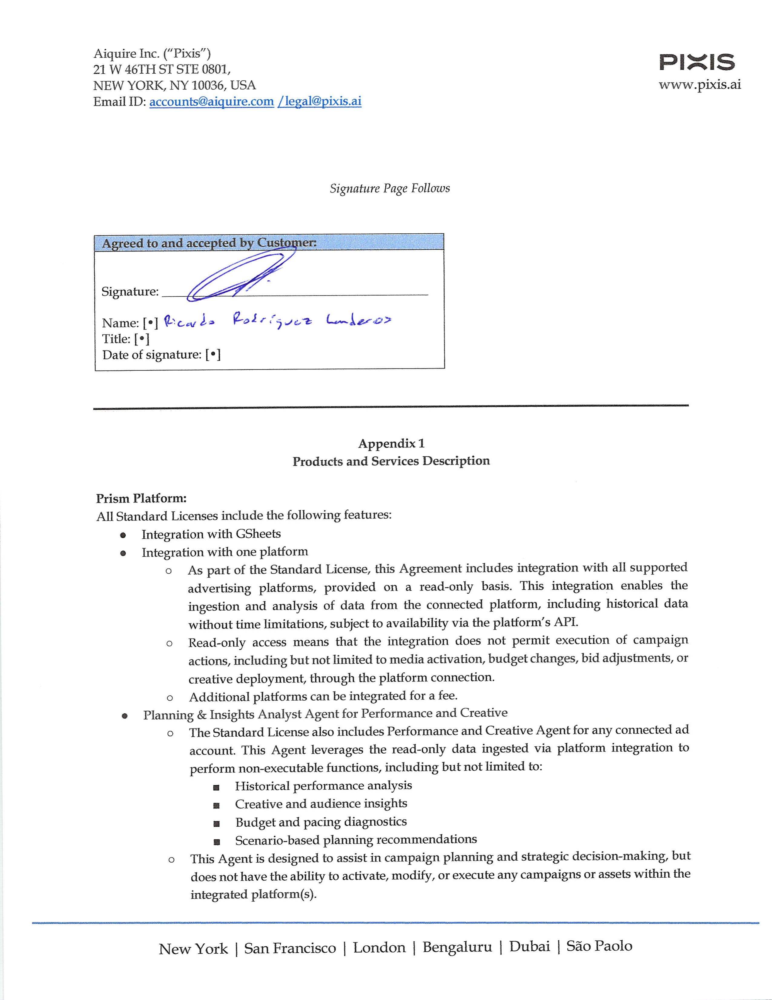


📝 Extracted Text:
------------------------------------------------------------
Aiquire Inc. (“Pixis”) —
21 W 46TH ST STE 0801, PIRIS
NEW YORK, NY 10036, USA www. pixis.ai

Email ID: accounts@aiquire.com /legal@pixis.ai

Signature Page Follows

Name: [e] ew de Ross oS Je Cwleo>
Title: [¢]
Date of signature: [°]

Appendix 1
Products and Services Description

Prism Platform:

All Standard Licenses include the following features:
e Integration with GSheets
e Integration with one platform

o As part of the Standard License, this Agreement includes integration with all supported
advertising platforms, provided on a read-only basis. This integration enables the
ingestion and analysis of data from the connected platform, including historical data
without time limitations, subject to availability via the platform’s API.

o Read-only access means that the integration does not permit execution of campaign
actions, including but not limited to media activation, budget changes, bid adjustments, or

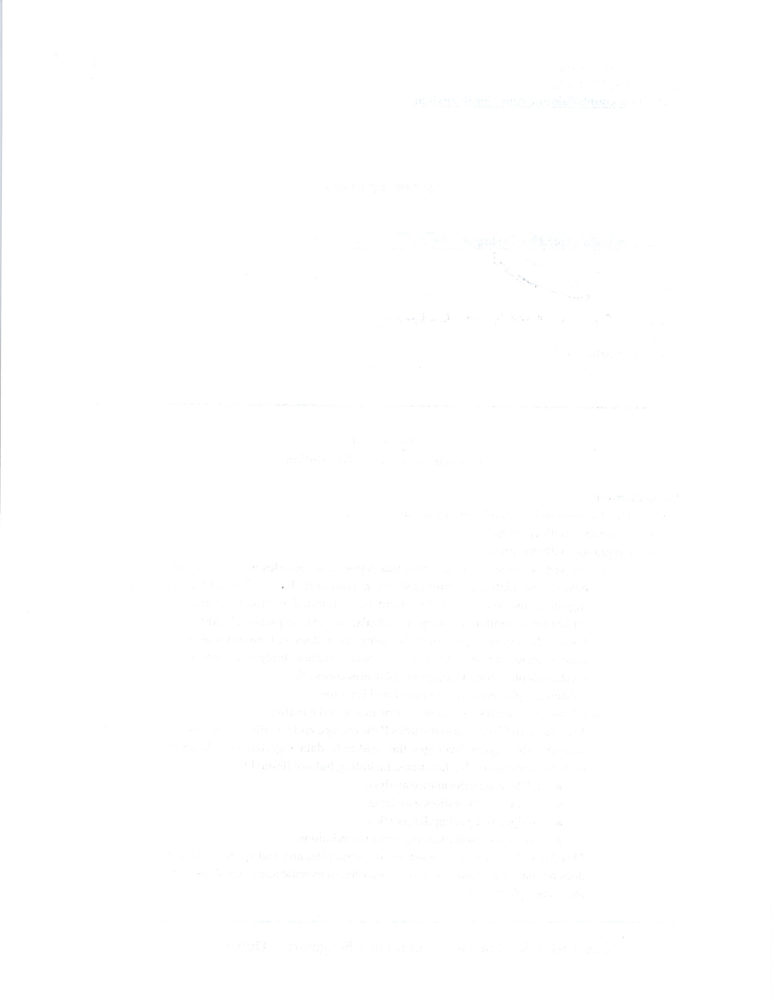


📝 Extracted Text:
------------------------------------------------------------
(No text found)
------------------------------------------------------------
💾 Text saved: output\page_008.txt

PAGE 9
💾 Image saved: output\page_009.png


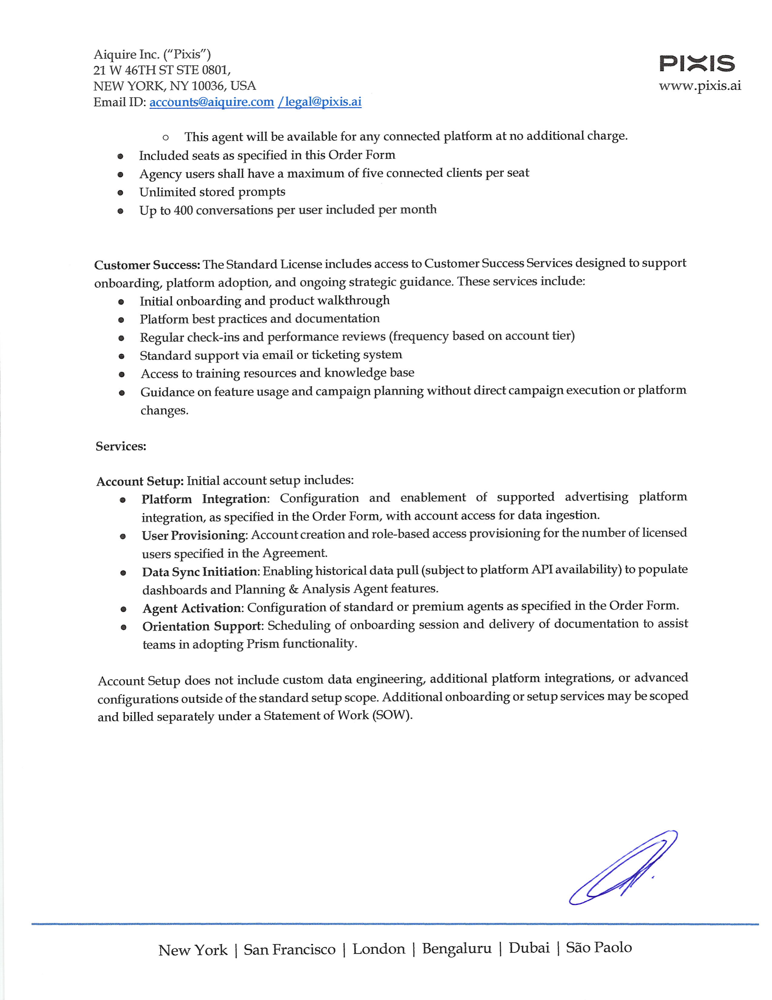


📝 Extracted Text:
------------------------------------------------------------
Aiquire Inc. (Pixis”)
21 W 46TH ST STE 0801, PIRIS
NEW YORK, NY 10036, USA WWW.pixis.ai

Email ID: accounts@aiquire.com /legal@pixis.ai

o This agent will be available for any connected platform at no additional charge.
Included seats as specified in this Order Form
Agency users shall have a maximum of five connected clients per seat
Unlimited stored prompts
Up to 400 conversations per user included per month

Customer Success: The Standard License includes access to Customer Success Services designed to support
onboarding, platform adoption, and ongoing strategic guidance. These services include:
e Initial onboarding and product walkthrough
Platform best practices and documentation

e Regular check-ins and performance reviews (frequency based on account tier)
e Standard support via email or ticketing system
e Access to training resources and knowledge base
e Guidance on feature usage and campaign planning 

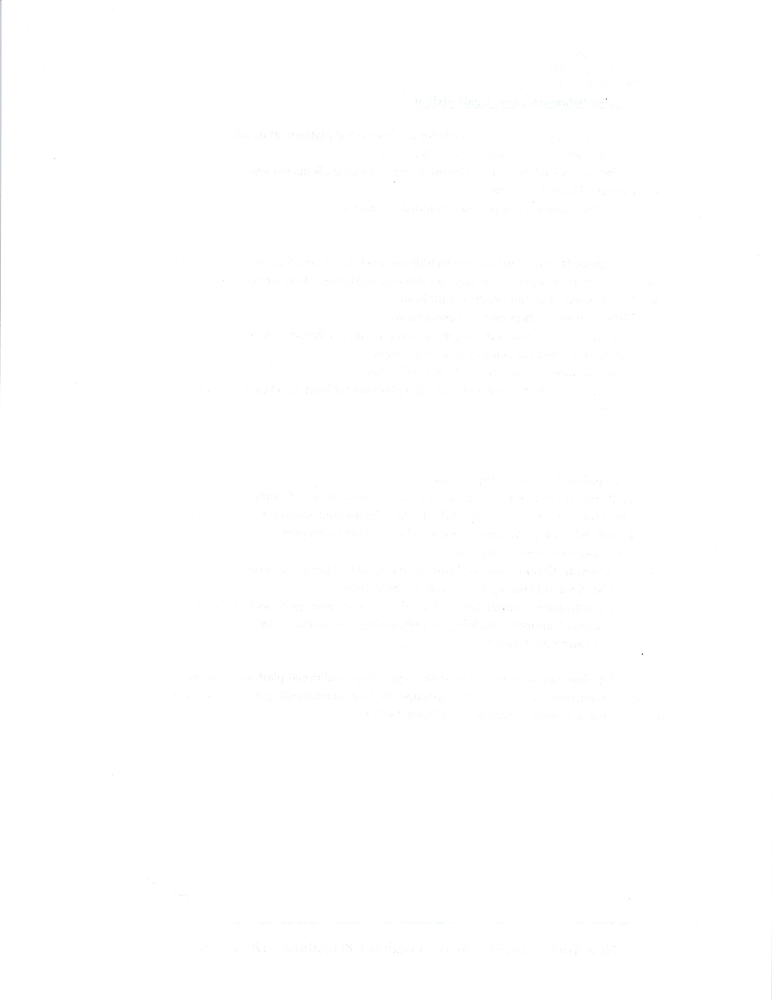


📝 Extracted Text:
------------------------------------------------------------
(No text found)
------------------------------------------------------------
💾 Text saved: output\page_010.txt

PAGE 11
💾 Image saved: output\page_011.png


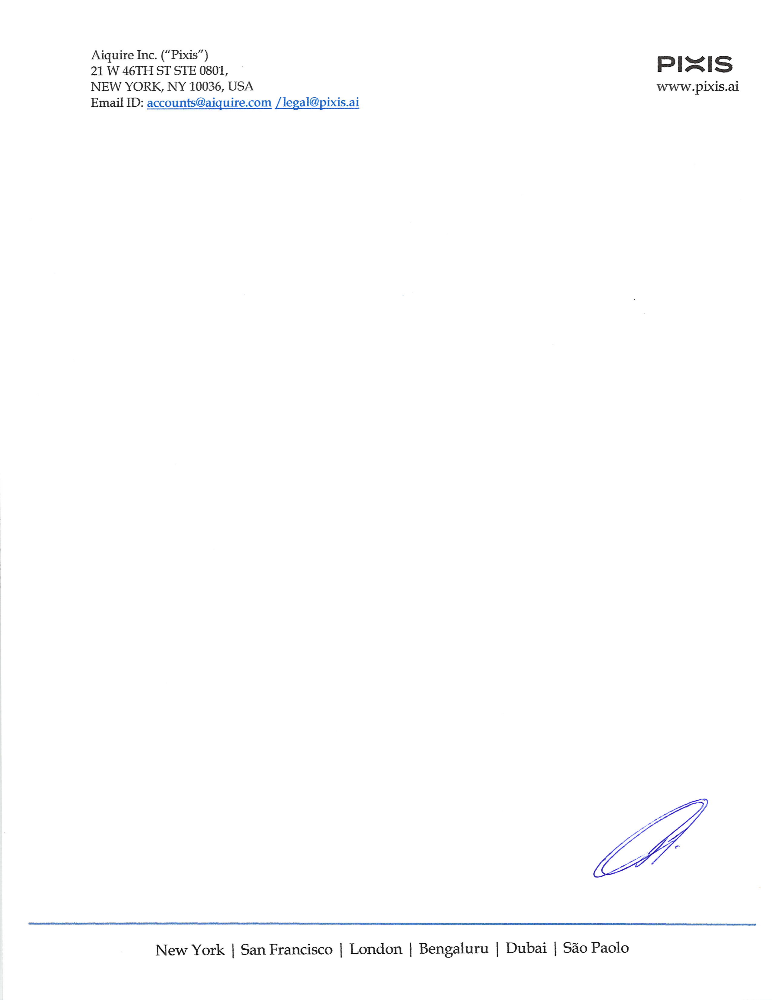


📝 Extracted Text:
------------------------------------------------------------
Aiquire Inc. (“Pixis”)
21 W 46TH ST STE 0801, PIRIS
NEW YORK, NY 10036, USA www.pixis.ai

Email ID: accounts@aiquire.com /legal@pixis.ai

New York | San Francisco | London | Bengaluru | Dubai | Sao Paolo
------------------------------------------------------------
💾 Text saved: output\page_011.txt

PAGE 12
💾 Image saved: output\page_012.png


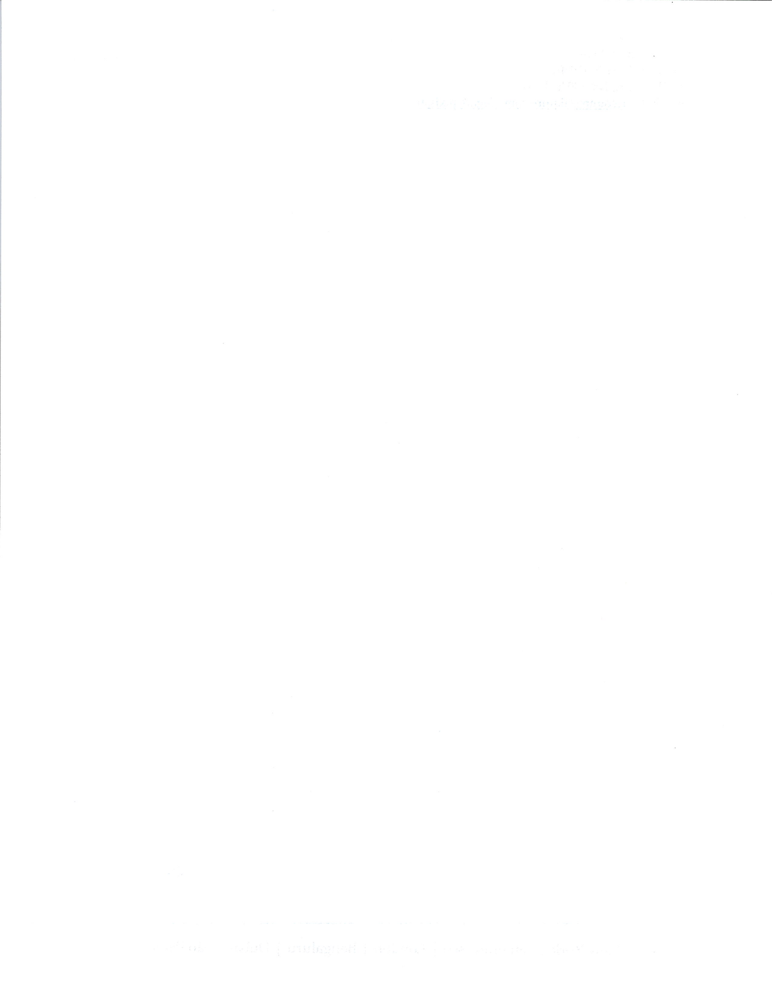


📝 Extracted Text:
------------------------------------------------------------
(No text found)
------------------------------------------------------------
💾 Text saved: output\page_012.txt


In [6]:
# Display results for each page
for page in result['pages']:
    page_num = page['page_number']
    text = page['text']
    image_base64 = page['image']
    
    print(f"\n{'='*60}")
    print(f"PAGE {page_num}")
    print(f"{'='*60}")
    
    # Decode and display image
    image_data = base64.b64decode(image_base64)
    image = Image.open(io.BytesIO(image_data))
    
    # Save image
    image_path = os.path.join(OUTPUT_DIR, f"page_{page_num:03d}.png")
    image.save(image_path)
    print(f"💾 Image saved: {image_path}")
    
    # Display image
    display(image)
    
    # Display text
    print(f"\n📝 Extracted Text:")
    print("-" * 60)
    print(text if text else "(No text found)")
    print("-" * 60)
    
    # Save text
    text_path = os.path.join(OUTPUT_DIR, f"page_{page_num:03d}.txt")
    with open(text_path, 'w', encoding='utf-8') as f:
        f.write(text)
    print(f"💾 Text saved: {text_path}")

In [7]:
# Summary
print(f"\n{'='*60}")
print(f"✅ Processing complete!")
print(f"   Total pages: {result['total_pages']}")
print(f"   Output directory: {OUTPUT_DIR}/")
print(f"   Files saved:")
print(f"   - Images: page_001.png, page_002.png, ...")
print(f"   - Text: page_001.txt, page_002.txt, ...")
print(f"{'='*60}")


✅ Processing complete!
   Total pages: 12
   Output directory: output/
   Files saved:
   - Images: page_001.png, page_002.png, ...
   - Text: page_001.txt, page_002.txt, ...
